<a href="https://colab.research.google.com/github/badreldin2/UnpackAICourse/blob/main/badr_week3_cars.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

     |████████████████████████████████| 727kB 5.5MB/s 
     |████████████████████████████████| 194kB 19.4MB/s 
     |████████████████████████████████| 1.2MB 18.7MB/s 
     |████████████████████████████████| 51kB 5.9MB/s 
     |████████████████████████████████| 776.8MB 24kB/s 
     |████████████████████████████████| 12.8MB 234kB/s 
     |████████████████████████████████| 61kB 5.7MB/s 
     |████████████████████████████████| 51kB 6.2MB/s 
ERROR: torchtext 0.9.0 has requirement torch==1.8.0, but you'll have torch 1.7.1 which is incompatible.
Mounted at /content/gdrive


In [5]:
from fastbook import *
from fastai.vision.widgets import *

In [6]:
key = os.environ.get('AZURE_SEARCH_KEY', '')

In [7]:
results = search_images_bing(key, 'formula 1 car')

In [8]:
ims = results.attrgot('contentUrl')
len(ims)

150

In [9]:
ims[0]

'http://cdntdreditorials.azureedge.net/cache/a/f/e/3/6/9/afe3697c643eb7a121b1039e97d9ab1cb8aa5142.jpg'

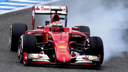

In [10]:
dest = 'formula1.jpg'
download_url(ims[0], dest, overwrite=True)
im = Image.open(dest)
im.to_thumb(128,128)

In [11]:
car_types = 'sedan','formula 1','4x4'
path = Path('cars')

In [12]:
if not path.exists():
    path.mkdir()
    for o in car_types:
        dest = (path/o)
        dest.mkdir(exist_ok=True)
        results = search_images_bing(key, f'{o} car')
        download_images(dest, urls=results.attrgot('contentUrl'))

In [17]:
im1=Image.open('/content/cars/4x4/00000000.jpg')

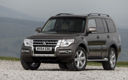

In [18]:
im1.to_thumb(128,128)

In [19]:
fns = get_image_files(path)

In [20]:
failed = verify_images(fns)
failed

(#2) [Path('cars/4x4/00000016.jpg'),Path('cars/4x4/00000098.jpg')]

In [21]:
failed.map(Path.unlink);

In [22]:
class DataLoaders(GetAttr):
    def __init__(self, *loaders): self.loaders = loaders
    def __getitem__(self, i): return self.loaders[i]
    train,valid = add_props(lambda i,self: self[i])

In [23]:
cars = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    #item_tfms=Resize(128)
    item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros')
    )

In [24]:
dls = cars.dataloaders(path)

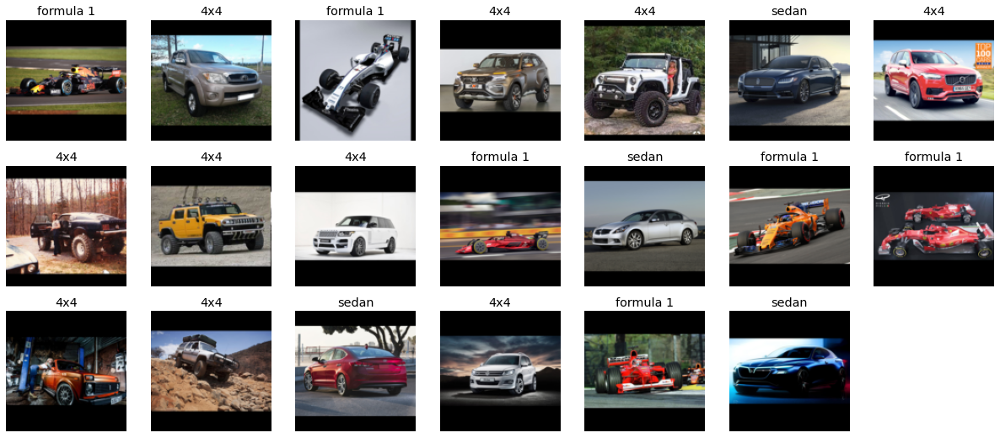

In [25]:
dls.valid.show_batch(max_n=20, nrows=3)

In [26]:
dls = cars.dataloaders(path)

In [ ]:
#Old version
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(6)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


epoch,train_loss,valid_loss,error_rate,time
0,1.944144,0.871638,0.380952,00:20


epoch,train_loss,valid_loss,error_rate,time
0,0.913073,1.487314,0.511905,00:19
1,0.667678,1.627889,0.535714,00:20
2,0.493073,1.729936,0.571429,00:20
3,0.405770,2.023762,0.619048,00:20
4,0.336695,2.322236,0.630952,00:20
5,0.283877,2.354631,0.654762,00:20


In [33]:
#new version
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.805956,1.039370,0.402439,00:18


epoch,train_loss,valid_loss,error_rate,time
0,0.905393,1.181606,0.463415,00:19
1,0.748602,1.127548,0.439024,00:19
2,0.611602,1.264528,0.463415,00:19
3,0.519038,1.317777,0.487805,00:19


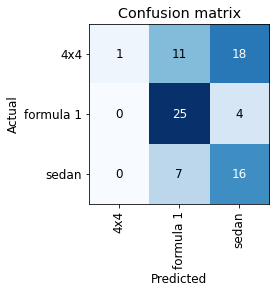

In [34]:
#new version
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [35]:
#new version
cleaner = ImageClassifierCleaner(learn)

In [36]:
#new
cleaner

In [37]:
#latest
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(30, base_lr=6*0.01)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


epoch,train_loss,valid_loss,error_rate,time
0,1.653553,4.956149,0.378049,00:19


epoch,train_loss,valid_loss,error_rate,time
0,1.494633,14.699100,0.475610,00:19
1,1.048456,6.327690,0.195122,00:19
2,0.765433,7.410320,0.378049,00:19
3,0.611210,2.492215,0.231707,00:19
4,0.502797,3.064258,0.243902,00:20
5,0.462046,5.107039,0.426829,00:19
6,0.465926,58.317585,0.536585,00:20
7,0.459318,5.437425,0.548781,00:20
8,0.425849,7.078092,0.658537,00:20
9,0.391220,2.474847,0.353659,00:19


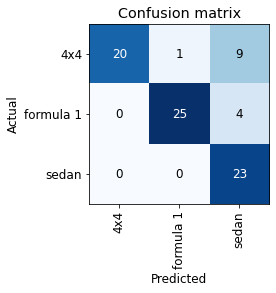

In [38]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [49]:
path1='/content/drive'
learn.export()

In [50]:
path = Path()


In [51]:
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [52]:
# latest
btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

In [53]:
#latest
img = PILImage.create(btn_upload.data[-1])
out_pl = widgets.Output()
out_pl.clear_output()
with out_pl: display(img.to_thumb(128,128))
out_pl

Output()

In [57]:
#latest
learn_inf = load_learner(path/'export.pkl')
pred,pred_idx,probs = learn_inf.predict(img)
lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: formula 1; Probability: 0.9985')

In [58]:
btn_run = widgets.Button(description='Classify')
btn_run

Button(description='Classify', style=ButtonStyle())

In [62]:
def on_click_classify(change):
    img = PILImage.create(btn_upload.data[-1])
    out_pl.clear_output()
    with out_pl: display(img.to_thumb(128,128))
    pred,pred_idx,probs = learn_inf.predict(img)
    lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'

btn_run.on_click(on_click_classify)

In [61]:
btn_upload = widgets.FileUpload()

In [63]:
VBox([widgets.Label('Select your bear!'), 
      btn_upload, btn_run, out_pl, lbl_pred])

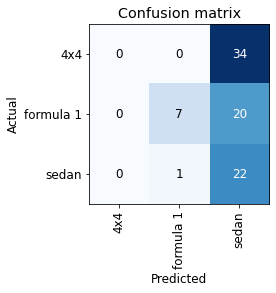

In [ ]:
#old version
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

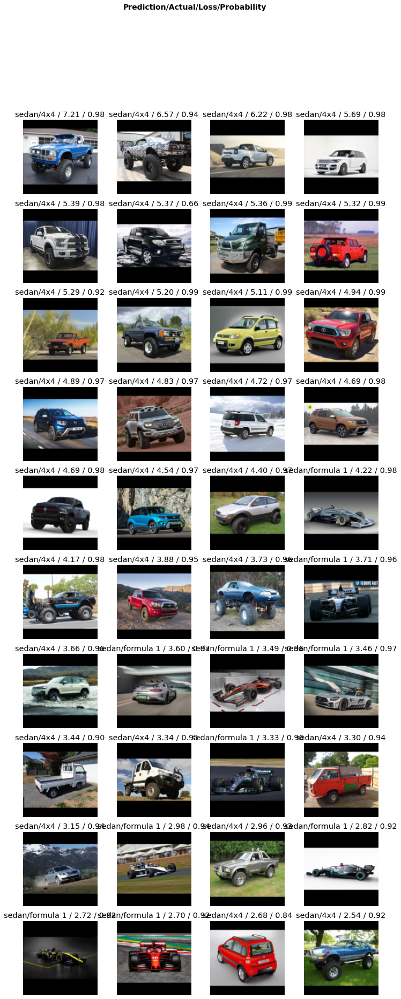

In [ ]:
interp.plot_top_losses(40 , nrows=10)

In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

FileNotFoundError: ignored

In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(3)

epoch,train_loss,valid_loss,error_rate,time
0,1.600893,0.924280,0.373494,00:20


epoch,train_loss,valid_loss,error_rate,time
0,0.852662,0.952391,0.385542,00:20
1,0.598420,1.245568,0.445783,00:19
2,0.470387,1.434482,0.518072,00:20


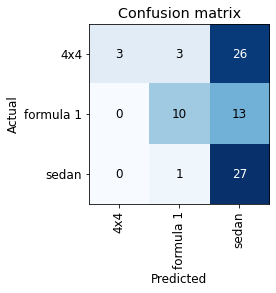

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


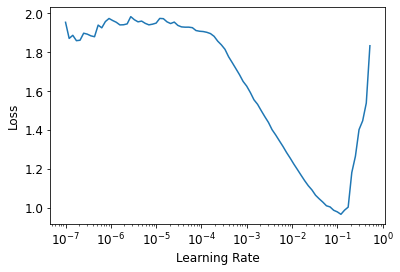

In [ ]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
lr_min,lr_steep = learn.lr_find()

In [ ]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(3, base_lr=0.1)

epoch,train_loss,valid_loss,error_rate,time
0,1.336618,3.719596,0.349398,00:20


epoch,train_loss,valid_loss,error_rate,time
0,2.494294,149.786270,0.650602,00:20
1,1.712823,1356.098877,0.602410,00:20
2,1.383861,84.731682,0.530120,00:20


In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(8, base_lr=0.01)

epoch,train_loss,valid_loss,error_rate,time
0,1.310350,0.448925,0.180723,00:20


epoch,train_loss,valid_loss,error_rate,time
0,0.510474,1.279580,0.361446,00:21
1,0.337280,1.861537,0.289157,00:20
2,0.276649,1.466350,0.228916,00:20
3,0.238844,1.404443,0.289157,00:20
4,0.201979,1.077599,0.253012,00:20
5,0.175359,1.166667,0.301205,00:20
6,0.149035,1.506562,0.313253,00:20
7,0.125590,1.639041,0.361446,00:20


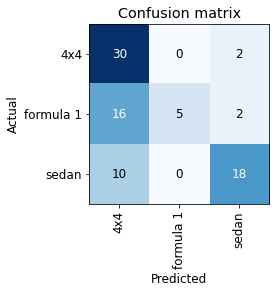

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

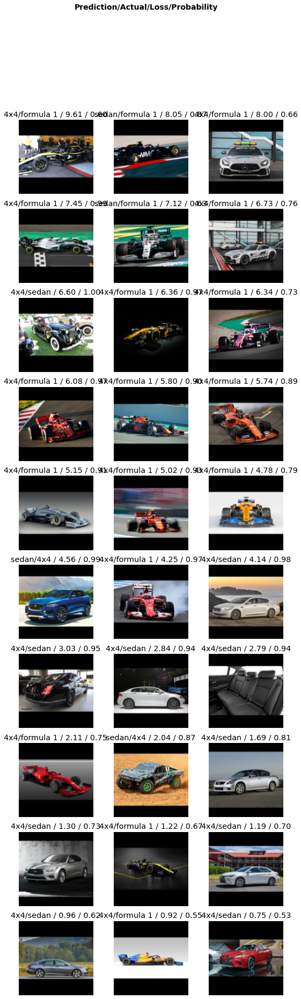

In [ ]:
interp.plot_top_losses(30, nrows=10)

In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [ ]:
cleaner

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

In [ ]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(8, base_lr=0.01)

epoch,train_loss,valid_loss,error_rate,time


FileNotFoundError: ignored

In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(8, base_lr=0.01)

epoch,train_loss,valid_loss,error_rate,time
0,1.394574,0.666770,0.170732,00:20


epoch,train_loss,valid_loss,error_rate,time
0,0.517378,0.774322,0.268293,00:20
1,0.361495,0.763131,0.207317,00:20
2,0.271570,0.884208,0.195122,00:20
3,0.245511,1.082007,0.219512,00:20
4,0.210442,2.029729,0.292683,00:20
5,0.180593,1.945809,0.292683,00:20
6,0.153308,1.861946,0.292683,00:20
7,0.134661,1.929859,0.304878,00:20


In [ ]:
cleaner = ImageClassifierCleaner(learn)

In [ ]:
cleaner

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

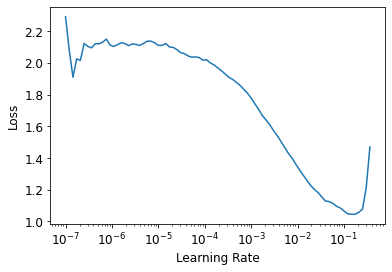

In [ ]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
lr_min,lr_steep = learn.lr_find()

In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(8, base_lr=6*0.01)

epoch,train_loss,valid_loss,error_rate,time
0,1.408543,4.783134,0.292683,00:20


epoch,train_loss,valid_loss,error_rate,time
0,0.920488,1.602680,0.304878,00:20
1,0.724254,14.857875,0.524390,00:20
2,0.605456,9.746704,0.475610,00:20
3,0.474132,0.758945,0.060976,00:20
4,0.410322,1.137603,0.121951,00:20
5,0.336488,0.646198,0.134146,00:20
6,0.280342,0.567531,0.158537,00:20
7,0.244701,0.638095,0.146341,00:20


In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(20, base_lr=6*0.01)

epoch,train_loss,valid_loss,error_rate,time
0,1.355102,8.486431,0.426829,00:19


epoch,train_loss,valid_loss,error_rate,time
0,0.991541,5.347772,0.268293,00:20
1,0.799490,5.887266,0.304878,00:20
2,0.620676,2.873415,0.195122,00:20
3,0.498866,5.918144,0.256098,00:20
4,0.438877,2.748876,0.268293,00:20
5,0.384519,4.012307,0.402439,00:20
6,0.356797,4.847840,0.390244,00:20
7,0.306465,5.019916,0.426829,00:20
8,0.290884,6.949326,0.463415,00:20
9,0.280575,4.985234,0.463415,00:20


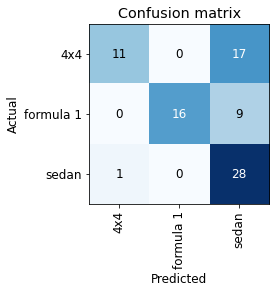

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
cleaner = ImageClassifierCleaner(learn)

In [ ]:
cleaner

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(20, base_lr=6*0.01)

epoch,train_loss,valid_loss,error_rate,time
0,1.234161,2.144936,0.312500,00:19


epoch,train_loss,valid_loss,error_rate,time
0,0.910739,5.314036,0.212500,00:20
1,0.603045,1.285074,0.175000,00:20
2,0.416063,1.158332,0.150000,00:20
3,0.316382,0.725109,0.162500,00:20
4,0.280272,1.381870,0.175000,00:20
5,0.295568,2.116187,0.162500,00:20
6,0.308045,0.708757,0.087500,00:21
7,0.264434,1.194385,0.187500,00:20
8,0.225812,1.592231,0.262500,00:20
9,0.213213,1.280016,0.150000,00:20


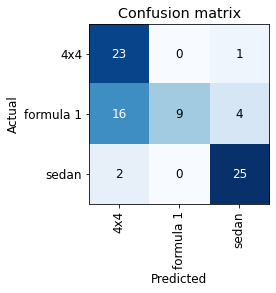

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
dls = cars.dataloaders(path)
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(30, base_lr=6*0.01)

epoch,train_loss,valid_loss,error_rate,time
0,1.312761,2.219223,0.225000,00:20


epoch,train_loss,valid_loss,error_rate,time
0,1.009893,1.539540,0.087500,00:20
1,0.585548,3.538030,0.287500,00:20
2,0.414881,1.947219,0.175000,00:20
3,0.331816,1.051500,0.112500,00:20
4,0.289681,2.159434,0.175000,00:20
5,0.265725,1.344309,0.162500,00:21
6,0.253596,2.858103,0.312500,00:20
7,0.231348,1.508482,0.137500,00:20
8,0.213208,1.911902,0.187500,00:20
9,0.188450,0.842790,0.112500,00:20


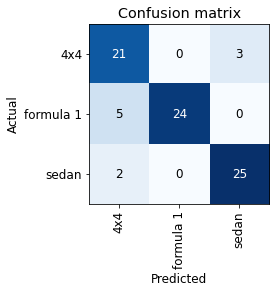

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
learn.export()

In [ ]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [ ]:
learn_inf = load_learner(path/'export.pkl')

In [ ]:
learn_inf.predict('formula1.jpg')

('formula 1', tensor(1), tensor([0.0106, 0.9624, 0.0271]))

In [ ]:
learn_inf.dls.vocab

['4x4', 'formula 1', 'sedan']

In [ ]:
btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

In [ ]:
img = PILImage.create(btn_upload.data[-1])

In [ ]:
out_pl = widgets.Output()
out_pl.clear_output()
with out_pl: display(img.to_thumb(128,128))
out_pl

Output()

In [ ]:
pred,pred_idx,probs = learn_inf.predict(img)

In [ ]:
lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: 4x4; Probability: 0.9991')

In [ ]:
btn_run = widgets.Button(description='Classify')
btn_run

Button(description='Classify', style=ButtonStyle())

In [ ]:
def on_click_classify(change):
    img = PILImage.create(btn_upload.data[-1])
    out_pl.clear_output()
    with out_pl: display(img.to_thumb(128,128))
    pred,pred_idx,probs = learn_inf.predict(img)
    lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'

btn_run.on_click(on_click_classify)

In [ ]:
btn_upload = widgets.FileUpload()

In [ ]:
VBox([widgets.Label('Select your car!'), 
      btn_upload, btn_run, out_pl, lbl_pred])